<a href="https://colab.research.google.com/github/40ina/Pet_Projects/blob/main/Geo_Moscow_2022.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Исследование города Москвы в разрезе транспортной безопасности и основных причин дорожно-транспортных происшествий



**Цель исследования**

Проанализировать по статистическим данным транспортную безопасность в городе Москва.

**Задачи исследования**

1. Анализ исторических данных:
- Внешние условия в момент ДТП. Когда происходит больше аварий и почему:
    - Время суток;
    - В какое время чаще всего совепшаются ДТП;
    - В какой день недели чаще всего происходят ДТП;
    - Сезон;
    - Срез по годам и месяцам за все время.
- Последствия:
    - Категория ДТП;
    - Тяжесть ДТП.
- Водитель:
    - Пол;
    - Стаж вождения;
    - В аварии какой степени тяжести попадают водители мужчины и водители женщины?
- Ситуация в городе:
    - В каких районах города происходит больше всего ДТП? Изучить самостоятельно причины;
    - Посмотреть в динамике, в каких районах количество аварий сокращается, а где увеличивается;
    - В каких районах было больше случаев со смертельным исходом и почему. В каких меньше;
    - В каких районах города участники ДТП чаще получают травмы?

2. Визуализация на карте 
- Визуализировать на карте ДТП в городе с помощью heatmap (за все время):
    - Районы по количеству ДТП.
- Визуализировать на карте ДТП района точками за год:
    - Аварии по сезонам;
    - Аварии, где водитель мужчина и водитель женщины;
    - Аварии по степени тяжести.

**Источник данных**

Сайт некоммерческого проекта «Карта ДТП»  ([https://dtp-stat.ru/opendata](https://dtp-stat.ru/opendata)).


**Описание данных**

`Структура данных:`

`id` - идентификатор;

`tags` - Дорожно-транспортные происшествия (показатели с официального сайта ГИБДД);

`light` - время суток;

`point` - координаты;

`nearby` - место, вблизи которого совершено ДТП; 

`region` - район Москвы;

`address` - адрес, по которому совершено ДТП;

`weather` - погода;

`category` - тип ДТП;

`datetime` - дата и время совершения ДТП;

`severity` - тяжесть ДТП/вред здоровью;

`vehicles` содержит информацию:

    
- участники – транспортные средства;
  - year - год производства транспортного средства;
  - brand - марка транспортного средства;
  - color - цвет транспортного средства;
  - model - модель транспортного средства;
  - category - категория транспортного средства;
- participants - участники внутри транспортных средств:
  - role - роль участника;
  - gender - пол участника;
  - violations - нарушения правил участником;
  - health_status - состояние здоровья участника;
  - years_of_driving_experience - стаж вождения участника (только у водителей);

`dead_count` - кол-во погибших в ДТП;

`participants` - участники без транспортных средств (описание, как у участников внутри транспортных средств);

`injured_count` - кол-во раненых в ДТП;

`parent_region` - регион;

`road_conditions` - состояние дорожного покрытия;

`participants_count` - кол-во участников ДТП;

`participant_categories` - категории участников.



`Таким образом, исследование пройдёт в 4 этапа:`

1. Обзор данных.
2. Подготовка данных.
3. Исследовательский анализ данных (EDA).
4. Подготовка презентации.

In [ ]:
!pip install geopandas
!pip install pyogrio
!pip install geopy
!pip install folium
!pip install descartes

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd
import seaborn as sns
import numpy as np
import geopandas as gpd
from shapely.geometry import Point, Polygon
import descartes
import pickle
import folium
import requests
import json
from geopy.geocoders import Nominatim

import matplotlib.pyplot as plt
%matplotlib inline

#pd.set_option('display.max_colwidth',1)

sns.set(context='notebook', style='ticks', palette='muted', font='sans-serif', font_scale=1, color_codes=True, rc={'figure.figsize':(15,5)} )

import warnings
warnings.filterwarnings('ignore')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
with open ('/content/drive/MyDrive/Colab Notebooks/Проект/Геоаналитика/Анализ ДТП в Москве/moskva.geojson', 'r') as j:
  contents = json.loads(j.read())

In [ ]:
data = gpd.GeoDataFrame.from_features(contents)

## Изучение данных из файла:

In [ ]:
data.sample()

,geometry,id,tags,light,point,nearby,region,scheme,address,weather,...,datetime,severity,vehicles,dead_count,participants,injured_count,parent_region,road_conditions,participants_count,participant_categories
50054,POINT (37.51097 55.77795),1573787,[Дорожно-транспортные происшествия],"В темное время суток, освещение включено","{'lat': 55.777955, 'long': 37.510972}",[Многоквартирные жилые дома],Хорошевский,820,"г Москва, ш Хорошёвское, 96",[Ясно],...,2019-02-19 17:50:00,Легкий,"[{'year': 2013, 'brand': 'MAZDA', 'color': 'Бе...",0,"[{'role': 'Пешеход', 'gender': 'Мужской', 'vio...",1,Москва,[Сухое],2,"[Все участники, Пешеходы]"


In [ ]:
data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 70475 entries, 0 to 70474
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   geometry                70475 non-null  geometry
 1   id                      70475 non-null  int64   
 2   tags                    70475 non-null  object  
 3   light                   70475 non-null  object  
 4   point                   70475 non-null  object  
 5   nearby                  70475 non-null  object  
 6   region                  70475 non-null  object  
 7   scheme                  68299 non-null  object  
 8   address                 65857 non-null  object  
 9   weather                 70475 non-null  object  
 10  category                70475 non-null  object  
 11  datetime                70475 non-null  object  
 12  severity                70475 non-null  object  
 13  vehicles                70475 non-null  object  
 14  dead_count    

In [ ]:
# количество пропущенных значений
data.isna().sum()

geometry                     0
id                           0
tags                         0
light                        0
point                        0
nearby                       0
region                       0
scheme                    2176
address                   4618
weather                      0
category                     0
datetime                     0
severity                     0
vehicles                     0
dead_count                   0
participants                 0
injured_count                0
parent_region                0
road_conditions              0
participants_count           0
participant_categories       0
dtype: int64

Пропущены данные в столбцах `scheme` и `address`

## Подготовка данных

In [ ]:
# изменим тип данных по столбцу 'datetime'
data['datetime'] = data['datetime'].astype('datetime64[ns]')

In [ ]:
# добавим столбец date только с датой ДТП, округленной до месяца
data['date'] = data['datetime'].astype('datetime64[M]')

In [ ]:
# добавим столбец с днем недели ДТП
data['day_of_week'] = data['datetime'].dt.day_name()

In [ ]:
# добавим столбец time со временем ДТП
data['time'] = data['datetime'].dt.hour

In [ ]:
# напишем функцию, чтобы добавить стаж вождения
def get_stage(cell):
    if len(cell) > 0:
        return (cell[0]['participants'][0]['years_of_driving_experience'])
    else: return np.nan
data['stage'] = data['vehicles'].apply(get_stage)   

In [ ]:
# напишем функцию, чтобы добавить пол водителя:
def get_sex(cell):
    if len(cell) > 0:
        return (cell[0]['participants'][0]['gender'])
    else: return np.nan
data['sex'] = data['vehicles'].apply(get_sex)  

In [ ]:
# добавим столбец с месяцем ДТП:
data['month_of_incident'] = data['datetime'].dt.month_name()

In [ ]:
# добавим столбец с годом ДТП:
data['year_of_incident'] = data['datetime'].dt.year

In [ ]:
# добавим столбец с временем года совершения ДТП:
def get_season(month):
    seasons = {
    'Осень': ['September', 'October', 'November'],
    'Весна': ['March', 'April', 'May'],
    'Лето': ['June', 'July', 'August'],
    'Зима': ['December', 'January', 'February']
    }

    for season in seasons:
        if month in seasons[season]:
            return season
        
data['season'] = data['month_of_incident'].apply(get_season)

In [ ]:
# рассмотрим данные за последние 5 лет (2017-2021). Данные за 2022 год не берем, т.к. они неполные
data_new = data[(data['datetime'] >= '2017-01-01') & (data['datetime'] < '2022-01-01')]

In [ ]:
# посчитаем количество пропусков в столбце address
len(data_new[data_new['address'].isna() == True])

3360

In [ ]:
# добавим столбцы с долготой и шириной
data_new['long'] = data_new.point.apply(lambda x: x['long'])
data_new['lat'] = data_new.point.apply(lambda x: x['lat'])

In [ ]:
data_new = data_new[(data_new['long'].notna()) | (data_new['lat'].notna())]

In [ ]:
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="my-appln")
location = geolocator.reverse("55.758448, 37.750729")
print(location.address)

31М, шоссе Энтузиастов, район Соколиная Гора, Москва, Центральный федеральный округ, 105275, Россия


In [ ]:
data_new['lat_long'] = data_new['lat'].astype('str') + ',' + data_new['long'].astype('str')

In [ ]:
data_new[['long', 'lat']].describe()

,long,lat
count,43909.000000,43909.000000
mean,37.579158,55.718836
std,0.508128,0.479232
min,1.000000,1.000000
25%,37.482326,55.656321
50%,37.585121,55.734952
75%,37.691400,55.808900
max,67.263800,88.815000


Координаты Москвы - 55.7522200, 37.6155600. 

Некоторые координаты в датасете не относятся к Москве. Удалим их

In [ ]:
data_new = data_new[(data_new['lat'] <= 56) & (data_new['lat'] >= 55) & (data_new['long'] >= 37) & (data_new['long'] <= 38)]
data_new[['long', 'lat']].describe()

,long,lat
count,43587.000000,43587.000000
mean,37.579649,55.726998
std,0.160183,0.122492
min,37.000000,55.000000
25%,37.484043,55.656854
50%,37.585876,55.735100
75%,37.691941,55.808695
max,37.995000,55.999996


In [ ]:
def fill_address(row):
  if row['address']==None:
    return geolocator.reverse(row['lat_long'])
  return row['address']

In [ ]:
data_new['address'] = data_new.apply(fill_address, axis=1)

In [ ]:
# посмотрим по каким столбцам у нас остались пропущенные данные
data_new.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 43587 entries, 0 to 70474
Data columns (total 32 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   geometry                43587 non-null  geometry      
 1   id                      43587 non-null  int64         
 2   tags                    43587 non-null  object        
 3   light                   43587 non-null  object        
 4   point                   43587 non-null  object        
 5   nearby                  43587 non-null  object        
 6   region                  43587 non-null  object        
 7   scheme                  42281 non-null  object        
 8   address                 43587 non-null  object        
 9   weather                 43587 non-null  object        
 10  category                43587 non-null  object        
 11  datetime                43587 non-null  datetime64[ns]
 12  severity                43587 non-null

In [ ]:
# удалим ненужные столбцы:
data_new = data_new.drop(columns=['scheme', 'vehicles', 'parent_region', 'participants'], axis=1)

In [ ]:
# удалим все пропущенные значения, т.к. отсутствуют значения по нужным для исследования столбцам (sex, stage)
data_new = data_new.dropna()

## Исследовательский анализ данных (EDA)

**Посмотрим общее количество ДТП за 5 лет:**

In [ ]:
cnt_incident = data_new.groupby('year_of_incident')['id'].count().sort_values(ascending = False).reset_index()
cnt_incident

,year_of_incident,id
0,2019,7741
1,2018,7476
2,2017,7376
3,2021,6857
4,2020,6467


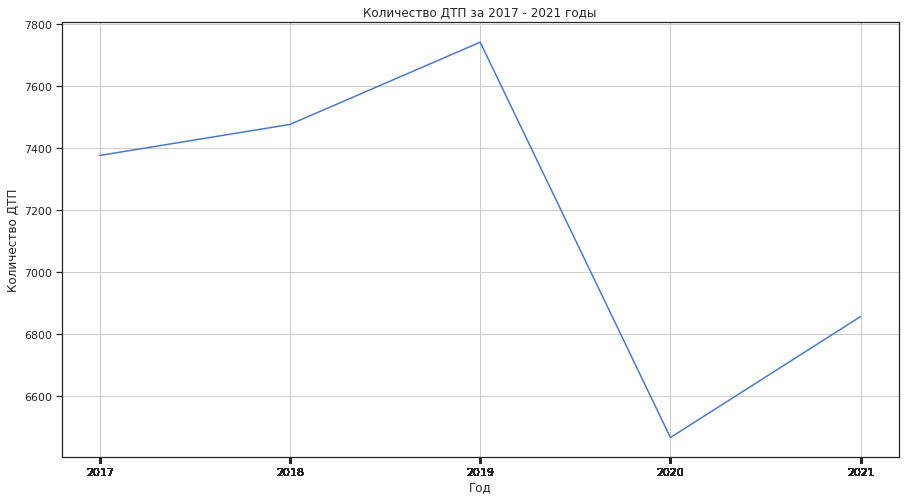

In [ ]:
sns.lineplot(data = data_new.groupby('year_of_incident')['id'].count().reset_index(), x = 'year_of_incident', y = 'id')
plt.title('Количество ДТП за 2017 - 2021 годы')
plt.ylabel('Количество ДТП')
plt.xlabel('Год')
plt.xticks(data_new.year_of_incident)
plt.grid(True)
plt.show()

Общее количество ДТП в период с 2017 по 2021 год по годам примерно одинаковое. 

С 2017 года по 2019 год общее количество ДТП постепенно увеличивалось.

В 2020 произошло снижение количества ДТП. Это вызвано введенными на территории 
г.Москвы ограничениями, связанными с пандемией COVID-19.

В 2021 году общее количество ДТП снова начало расти.

**ВНЕШНИЕ УСЛОВИЯ В МОМЕНТ ДТП**

**В какое время суток чаще всего происходят ДТП:**

In [ ]:
light= data_new.pivot_table(index='light', values='id', aggfunc = 'count').rename(columns={'id':'count'})
light['ratio'] = (data_new.light.value_counts(normalize = True) * 100).round(2)
light = light.sort_values(by='count', ascending=False).reset_index()
light

,light,count,ratio
0,Светлое время суток,21194,59.01
1,"В темное время суток, освещение включено",14006,39.00
2,Сумерки,487,1.36
3,"В темное время суток, освещение отсутствует",158,0.44
4,"В темное время суток, освещение не включено",72,0.20


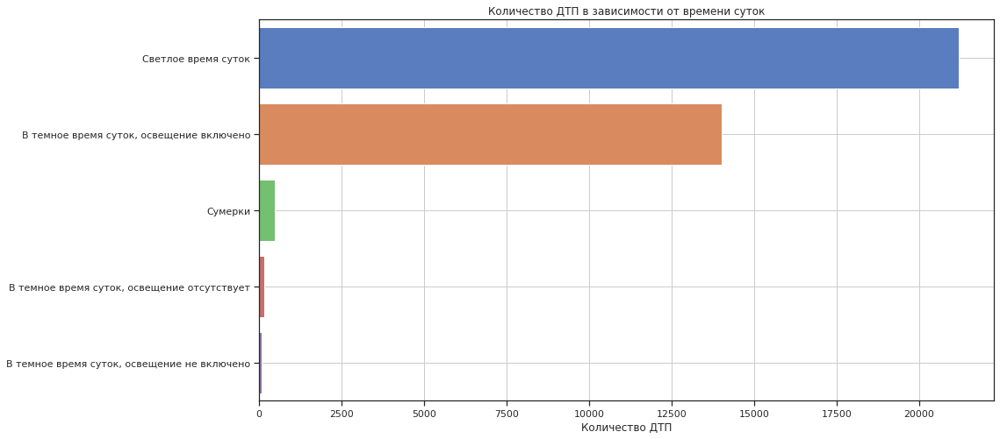

In [ ]:
sns.barplot(data = data_new.groupby('light')['id'].count().reset_index().sort_values(by = 'id', ascending = False), x = 'id', y = 'light')
plt.title('Количество ДТП в зависимости от времени суток')
plt.ylabel('')
plt.xlabel('Количество ДТП')
plt.grid(True)
plt.show()

Так как большая часть аварий совершается в светлое время суток и в темное время суток с включенным освещением, посмотрим распределение количества ДТП при указанном освещении по годам:

In [ ]:
l1 = data_new.groupby(['light', 'year_of_incident'])['id'].count().sort_values(ascending = False).reset_index().rename(columns={'id':'count'})
l1 = l1.head(10)

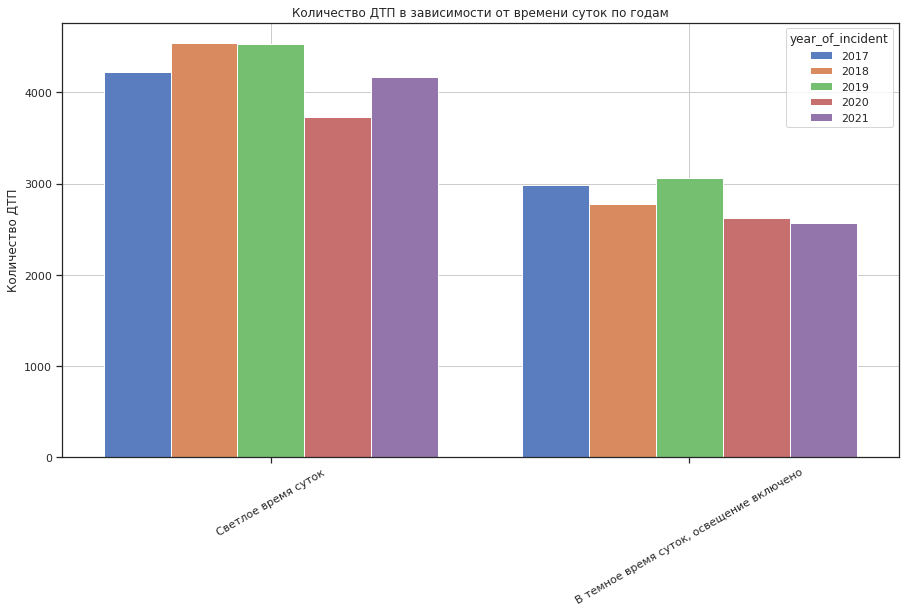

In [ ]:
sns.barplot(data = l1, x ='light', y = 'count', hue = 'year_of_incident')
plt.title('Количество ДТП в зависимости от времени суток по годам')
plt.ylabel('Количество ДТП')
plt.xticks(rotation=30)
plt.xlabel('')
plt.grid(True)
plt.show()

 В светлое время суток количество аварий количество аварий распределено примерно одинаково, за исключением 2020 года, когда их количество снизилось.

 В темное время суток при включенном освещении рост количества аварий к 2021 году постепенно снижается.

**В какое время чаще всего совершаются ДТП:**

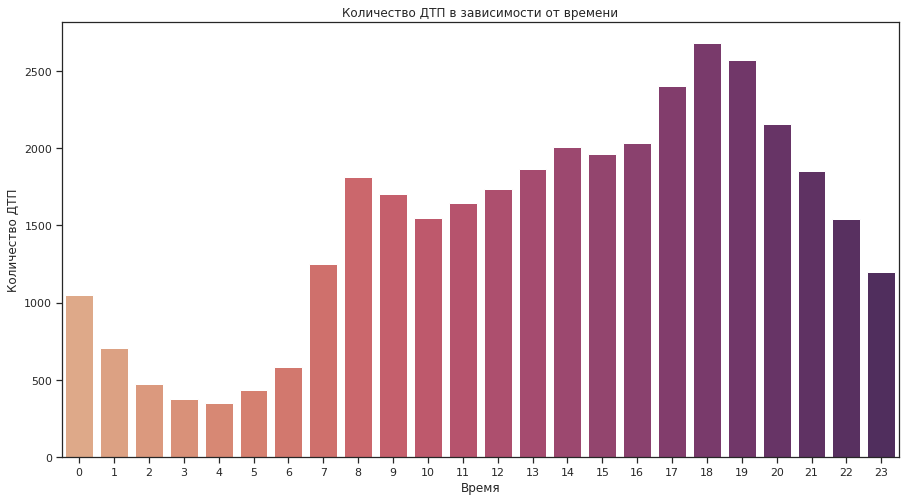

In [ ]:
sns.barplot(data = data_new.groupby('time').agg({'id': 'nunique'}).reset_index(), x='time', y='id', palette='flare')
plt.title('Количество ДТП в зависимости от времени')
plt.xlabel('Время')
plt.ylabel("Количество ДТП")
plt.show()

В ночное время - с 2 часов ночи до 4 утра - количество аварий снижается.

В начале трудового дня количество аварий постепенно увеличивается, достигая пика к 18-19 часам (окончание рабочего дня)

**В какой день недели чаще всего происходят ДТП:**

In [ ]:
week_day = data_new.pivot_table(index='day_of_week', values='id', aggfunc = 'count').rename(columns={'id':'count'})
week_day.sort_values(by = 'count', ascending=False)

,count
day_of_week,
Tuesday,5473
Friday,5459
Thursday,5452
Wednesday,5299
Monday,5261
Saturday,4793
Sunday,4180


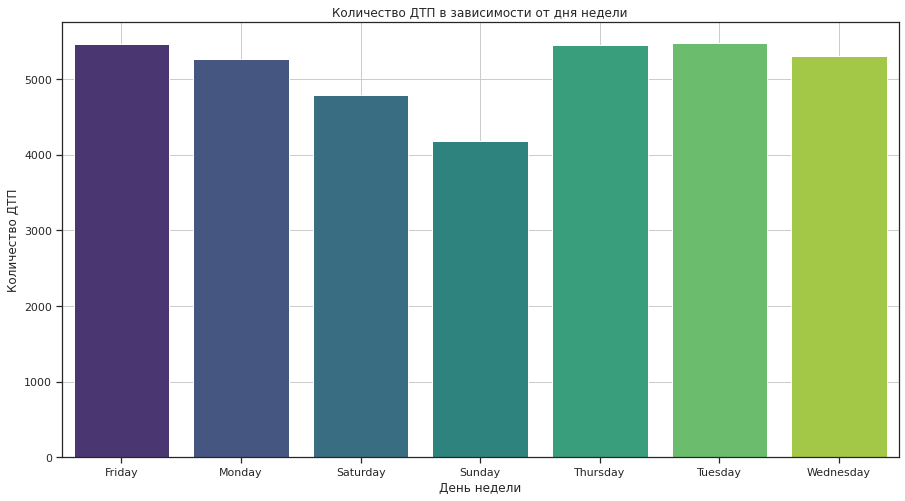

In [ ]:
sns.barplot(data = data_new.groupby('day_of_week').agg({'id': 'nunique'}).reset_index(), x='day_of_week', y='id', palette='viridis')
plt.title('Количество ДТП в зависимости от дня недели')
plt.xlabel('День недели')
plt.ylabel("Количество ДТП")
plt.grid(True)
plt.show()

В будние дни наблюдается наибольшее количество аварий. В выходные дни оно немного снижается. Видимо, в выходные дни люди реже используют автотранспорт.

Наибольшее количество ДТП совершается по вторникам, четвергам и пятницам.

Меньше всего - в воскресенье.

**При каких погодных условиях чаще всего совершаются ДТП:**

In [ ]:
# переведем данные из столбцов `weather` и `road_conditions`в строковый тип данных
data_new.weather = data_new.weather.apply(lambda x: ''.join(i for i in x))
data_new.road_conditions = data_new.road_conditions.apply(lambda x: ''.join(i for i in x))

In [ ]:
weather = data_new.pivot_table(index='weather', values='id', aggfunc = 'count').rename(columns={'id':'count'})
weather['ratio'] = (data_new.weather.value_counts(normalize = True) * 100).round(2)
weather.sort_values(by='count', ascending=False).reset_index()

,weather,count,ratio
0,Пасмурно,18489,51.48
1,Ясно,14975,41.69
2,Дождь,1432,3.99
3,Снегопад,690,1.92
4,ПасмурноДождь,196,0.55
5,ПасмурноСнегопад,82,0.23
6,ЯсноТемпература выше +30С,16,0.04
7,Туман,12,0.03
8,ДождьСнегопад,6,0.02
9,Метель,6,0.02


In [ ]:
w1 = data_new.groupby('weather')['id'].count().sort_values(ascending = False).reset_index().rename(columns={'id':'count'})
w1 = w1.head(5)

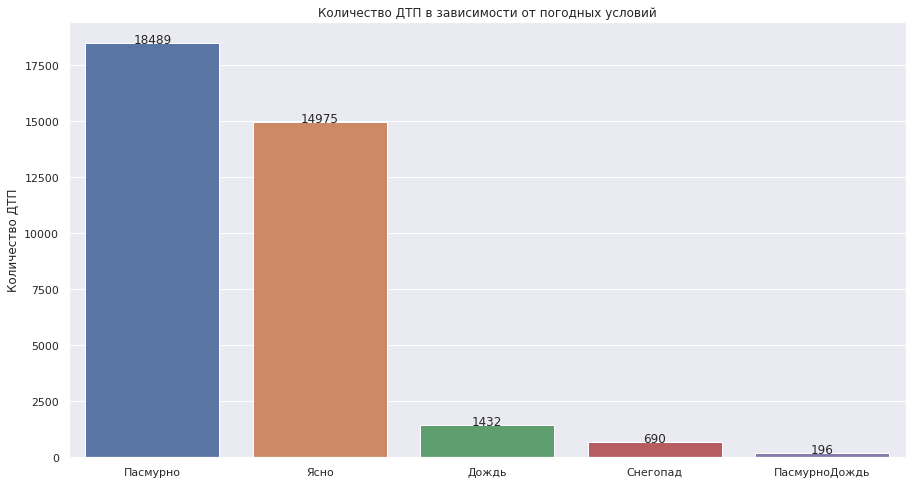

In [ ]:
sns.set(rc={'figure.figsize':(15,8)})
ax = sns.barplot(x='weather', y='count', data=w1)
ax.set(title='Количество ДТП в зависимости от погодных условий')
ax.set_ylabel('Количество ДТП')
ax.set_xlabel('')
ax.tick_params(axis='x')

for p in ax.patches:
  height = p.get_height()
  ax.text(x = p.get_x()+(p.get_width()/2), 
  y = height+0.5, 
  s = '{:.0f}'.format(height), 
  ha = 'center')

**Состояние дороги в момент ДТП:**

In [ ]:
road_conditions= data_new.pivot_table(index='road_conditions', values='id', aggfunc = 'count').rename(columns={'id':'count'})
road_conditions['ratio'] = (data_new.road_conditions.value_counts(normalize = True) * 100).round(2)
road_conditions.sort_values(by='count', ascending=False).reset_index()

,road_conditions,count,ratio
0,Сухое,19028,52.98
1,Мокрое,8550,23.80
2,Обработанное противогололедными материалами,2143,5.97
3,Заснеженное,1068,2.97
4,"СухоеОтсутствие, плохая различимость горизонта...",780,2.17
...,...,...,...
258,Несоответствие дорожных ограждений предъявляем...,1,0.00
259,Несоответствие дорожных ограждений предъявляем...,1,0.00
260,Несоответствие дорожных ограждений предъявляем...,1,0.00
261,Несоответствие люков смотровых колодцев и ливн...,1,0.00





`В период с 2017 по 2021 год наибольшее количество аварий происходит (доля от общего количества аварий):`
- в светлое время суток - 59%;
- в темное время суток при включенном освещении - 39%.

Доля ДТП в другое время суток (сумерки, в темное время суток при отсутствующем освещении) незначительна - менее 1% от всего количества аварий.

Количество аварий возрастает с началом рабочего дня (с 7 до 8 часов утра).
В течение дня оно постепенно увеличивается. Наибольшее количество ДТП совершается в период времени с 17 до 19 часов.


Наибольшее количество ДТП совершается по вторникам, четвергам и пятницам.

Меньше всего - в воскресенье.

`Погодные условия в момент совершения ДТП (доля от общего количества аварий):`
- пасмурно - 51%;
- ясно - 42%;
- дождь -4%.

`Дорожное покрытие в момент ДТП, в основном (доля от общего количества аварий):`
- сухое - 53%;
- мокрое -24%.

В какое время года чаще всего происходят аварии:

In [ ]:
season= data_new.pivot_table(index='season', values='id', aggfunc = 'count').rename(columns={'id':'count'})
season['ratio'] = (data_new.season.value_counts(normalize = True) * 100).round(2)
season.sort_values(by='count', ascending=False).reset_index()

,season,count,ratio
0,Осень,10426,29.03
1,Лето,8982,25.01
2,Зима,8617,23.99
3,Весна,7892,21.97


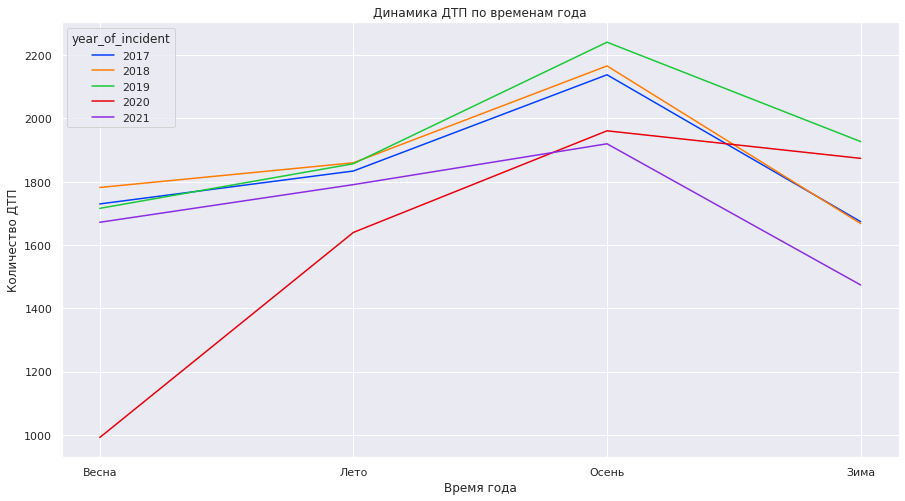

In [ ]:
sns.lineplot(data = data_new.groupby(['season', 'year_of_incident'])['id'].count().loc[['Весна', 'Лето', 'Осень', 'Зима']].reset_index(),
             x = 'season', y = 'id', hue = 'year_of_incident', palette="bright")
plt.title('Динамика ДТП по временам года')
plt.ylabel('Количество ДТП')
plt.xlabel('Время года')
plt.grid(True)
plt.show()

`В 2017 году` весной и зимой количество аварий было примерно одинаковым, летом и осенью их количество сильно увеличилось.

`В 2018 году` ситуация на дорогах в зависимости от времени года по сравнению с 2017 годом не изменилась.

`В 2019 году` зимой и летом количество аварий было примерно одинаковым, к осени их количество сильно увеличилось. 

`В 2020 году` в период ограничений из-за пандемии (весна) количество аварий было самым низким за весь исследуемый период. После ослабления ограничений количество аварий начало резко расти.

`В 2021 году` в течение года количество аварий росло, но не так сильно как в предыдущие годы. К зиме рост количества ДТП начал снижаться.

`Увеличение количества ДТП в осенне-зимний сезон связано:` с ухудшением погодных условий, а также трудностью перехода некоторых водителей на особенности зимнего стиля вождения.

`Увеличение количества ДТП в летний сезон, в основном, связано:`
- с появлением множества велосипедов, скутеров и мотоциклов;
- с жаркой погодой, которая негативно влияет на автомобилистов. Снижается скорость реакции, стиль вождения становится более агрессивным.

**Распределение количества ДТП по годам и месяцам за период с 2017 по 2021 год:**

In [ ]:
# напишем функцию для построения графиков:
def get_grafic(index, values, title, ylabel, xlabel, kind):
    data_new.pivot_table(index = index, values = values, aggfunc = 'count').plot(kind = kind)
    plt.legend('')
    plt.title(title)
    plt.ylabel(ylabel)
    plt.xlabel(xlabel)
    plt.grid(True)
    plt.show()

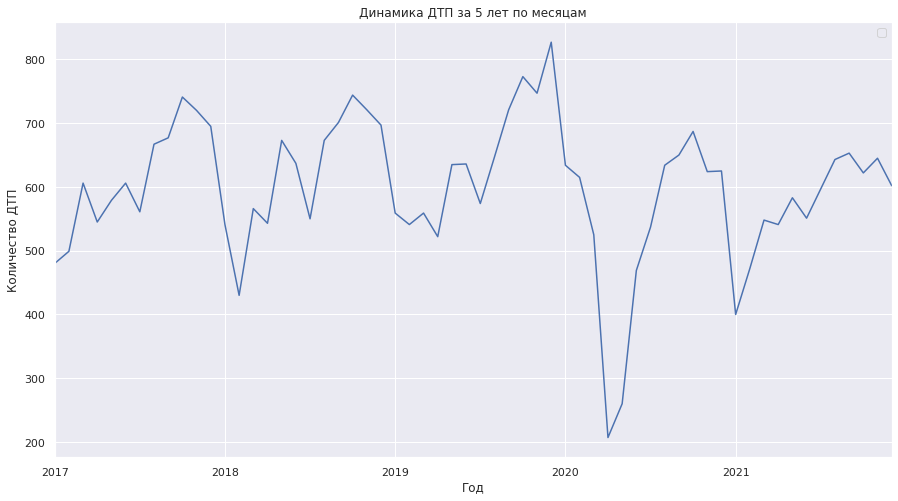

In [ ]:
get_grafic('date', 'id', 'Динамика ДТП за 5 лет по месяцам', 'Количество ДТП', 'Год', 'line')

In [ ]:
data_new.pivot_table(index = 'month_of_incident', values = 'id', aggfunc = 'count').sort_values(by='id', ascending=False)\
                    .rename(columns={'id':'count'}).reset_index()

,month_of_incident,count
0,October,3567
1,November,3457
2,December,3446
3,September,3402
4,August,3264
5,June,2899
6,July,2819
7,March,2804
8,May,2730
9,January,2614


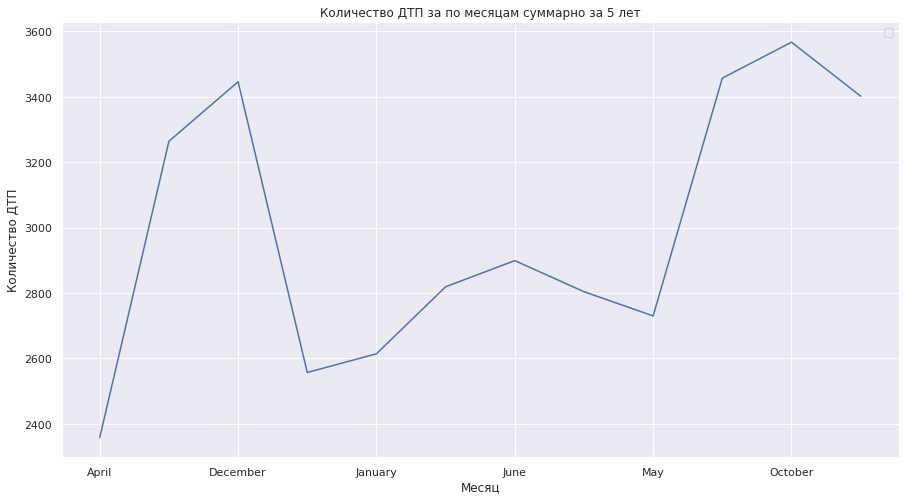

In [ ]:
get_grafic('month_of_incident', 'id', 'Количество ДТП за по месяцам суммарно за 5 лет', 'Количество ДТП', 'Месяц','line')

Как видим, в первом квартале, вне зависимости от года, количество аварий незначительно. К лету оно начинает постепенно увеличиваться, достигая пика к 3 кварталу, началу осенне-зимнего сезона.

Исключением стал первый квартал 2020 года, в котором количество совершенных ДТП снизилосб до минимума. Это вызвано введением ограничений на передвижение (локдаун) в период пандемии. После частичного снятия ограничений количество аварий стало снова расти.

**ПОСЛЕДСТВИЯ ДТП:**

**Категории совершенных ДТП:**

In [ ]:
category= data_new.pivot_table(index='category', values='id', aggfunc = 'count')
category.columns = ['count']
category['ratio'] = (data_new.category.value_counts(normalize = True) * 100).round(2)
category.sort_values(by='count', ascending=False).reset_index()

,category,count,ratio
0,Столкновение,16726,46.57
1,Наезд на пешехода,13846,38.55
2,Наезд на стоящее ТС,1727,4.81
3,Наезд на препятствие,1714,4.77
4,Наезд на велосипедиста,903,2.51
5,Падение пассажира,478,1.33
6,Опрокидывание,376,1.05
7,"Наезд на лицо, не являющееся участником дорожн...",34,0.09
8,Съезд с дороги,23,0.06
9,Иной вид ДТП,20,0.06


In [ ]:
c1 = data_new.groupby('category')['id'].count().sort_values(ascending = False).reset_index().rename(columns={'id':'count'})
c1 = c1.head(7)

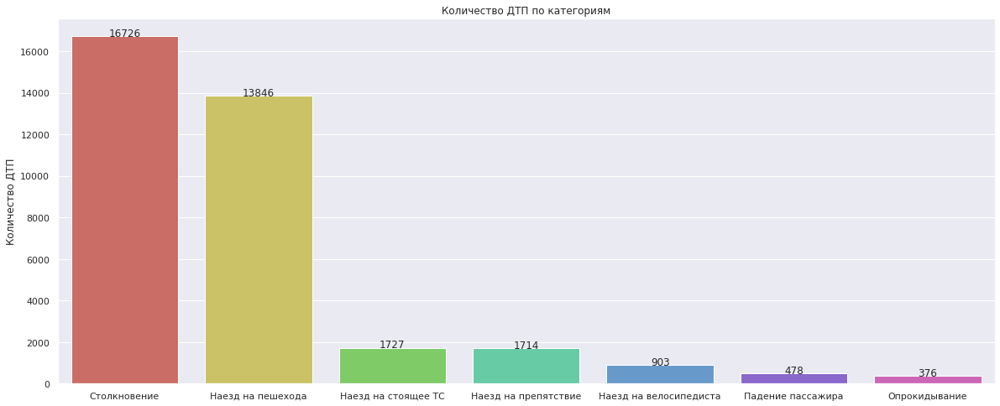

In [ ]:
sns.set(rc={'figure.figsize':(20,8)})
ax = sns.barplot(x='category', y='count', data=c1, palette = 'hls')
ax.set(title='Количество ДТП по категориям')
ax.set_ylabel('Количество ДТП')
ax.set_xlabel('')
ax.tick_params(axis='x')

for p in ax.patches:
  height = p.get_height()
  ax.text(x = p.get_x()+(p.get_width()/2), 
  y = height+0.5, 
  s = '{:.0f}'.format(height), 
  ha = 'center')

**47%** совершенных в 2017-2021 годах ДТП - **столкновение**.

**39%**  - **наезд на пешехода**.

Доля остальных категорий ДТП незначительна.

**Последствия совершенных ДТП:**

In [ ]:
severity= data_new.pivot_table(index='severity', values='id', aggfunc = 'count')
severity.columns = ['count']
severity['ratio'] = (data_new.severity.value_counts(normalize = True) * 100).round()
severity.sort_values(by='count', ascending=False).reset_index()

,severity,count,ratio
0,Легкий,25877,72.0
1,Тяжёлый,8443,24.0
2,С погибшими,1597,4.0


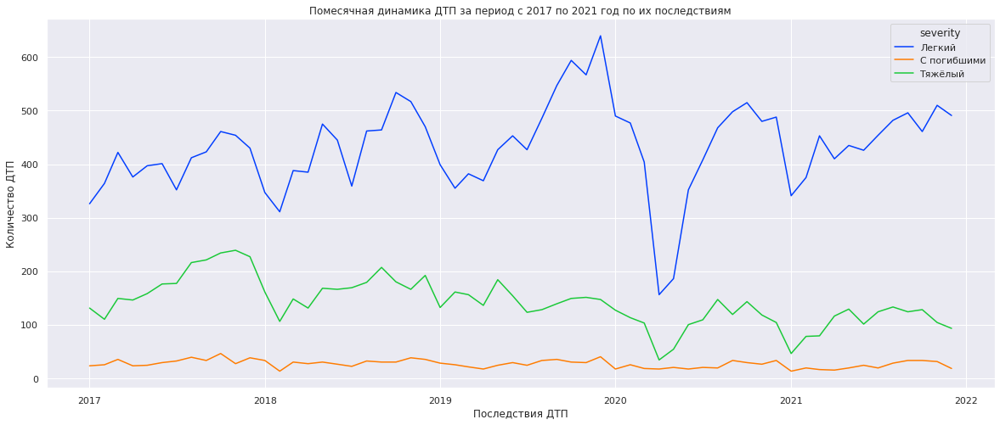

In [ ]:
sns.lineplot(data =data_new.groupby(['date','severity'])['id'].count().reset_index(), x = 'date', y = 'id', hue = 'severity', palette='bright')
plt.title('Помесячная динамика ДТП за период с 2017 по 2021 год по их последствиям')
plt.ylabel('Количество ДТП')
plt.xlabel('Последствия ДТП')
plt.grid(True)
plt.show()

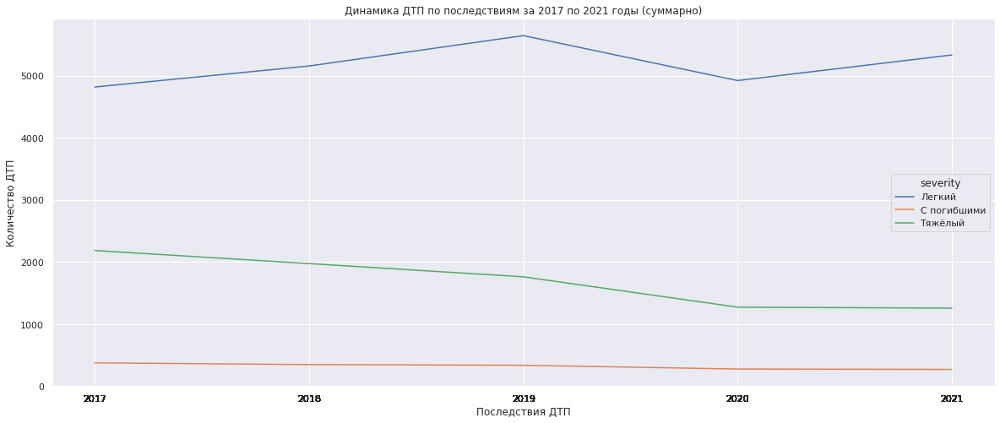

In [ ]:
sns.lineplot(data = data_new.groupby(['year_of_incident','severity'])['id'].count().reset_index(), x = 'year_of_incident', y = 'id', hue = 'severity')
plt.title('Динамика ДТП по последствиям за 2017 по 2021 годы (суммарно)')
plt.ylabel('Количество ДТП')
plt.xlabel('Последствия ДТП')
plt.xticks(data_new.year_of_incident)
plt.grid(True)
plt.show()

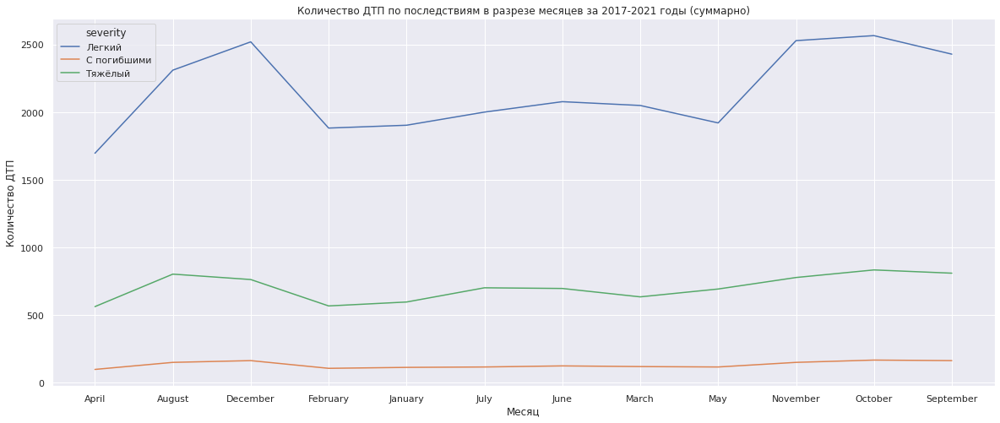

In [ ]:
sns.lineplot(data = data_new.groupby(['month_of_incident', 'severity'])['id'].count().reset_index(), x = 'month_of_incident', y = 'id', hue = 'severity')
plt.title('Количество ДТП по последствиям в разрезе месяцев за 2017-2021 годы (суммарно)')
plt.ylabel('Количество ДТП')
plt.xlabel('Месяц')
plt.grid(True)
plt.show()

`В исследуемый период ДТП по степени тяжести распределяются следующим образом:`
- легкая: 72%;
- тяжелая: 24%;
- с погибшими: 4%.

Наибольшее число аварий любой степени тяжести совершается в осенне-зимний период. 

В весенний период количество аварий с последствиями снижается.

Количество ДТП с погибшими практически не изменяется со временем, с тяжелыми последствиями - наблюдается небольшой спад, с легкими, напротив, растут во времени.

**ВОДИТЕЛИ:**

**Пол участников ДТП:**

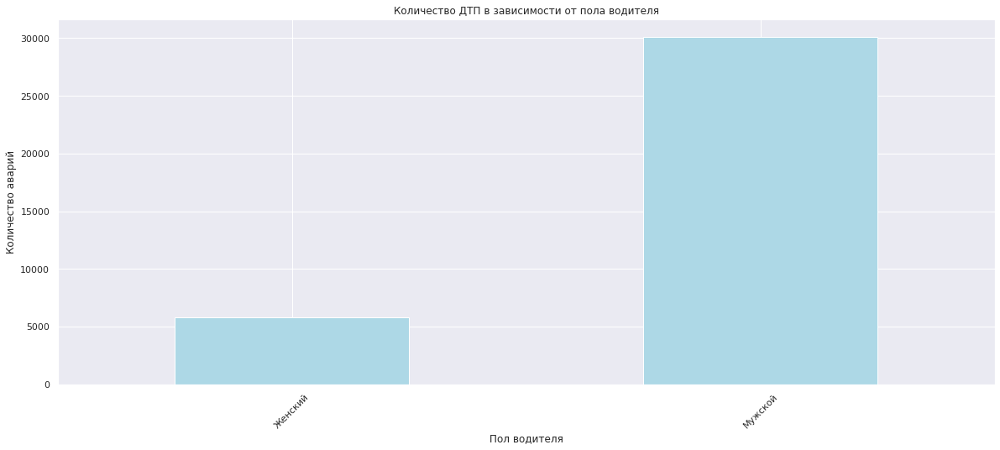

In [ ]:
data_new.groupby('sex')['id'].count().plot(kind = 'bar', color = 'lightblue', rot = 45, grid=True)
plt.title('Количество ДТП в зависимости от пола водителя')
plt.ylabel('Количество аварий')
plt.xlabel('Пол водителя')
plt.show()

In [ ]:
sex = data_new.pivot_table(index='sex', values='id', aggfunc = 'count')
sex.columns = ['count']
sex['ratio'] = (data_new.sex.value_counts(normalize = True) * 100).round()
sex.sort_values(by='count', ascending=False).reset_index()

,sex,count,ratio
0,Мужской,30138,84.0
1,Женский,5779,16.0


Доля виновников в совершенных ДТП по полу:
- мужчины - 84%;
- женщины - 16%.

Это связано с тем, что женщин-водителей гораздо меньше, чем мужчин, и они более аккуратны и внимательнее при вождении.

**Водительский стаж участников ДТП:**

In [ ]:
stage = data_new.pivot_table(index='stage', values='id', aggfunc = 'count')
stage.columns = ['count']
stage.sort_values(by='count', ascending=False).head(10).reset_index()

,stage,count
0,5.0,1653
1,2.0,1650
2,3.0,1617
3,9.0,1571
4,1.0,1554
5,8.0,1495
6,12.0,1489
7,7.0,1487
8,10.0,1479
9,4.0,1446


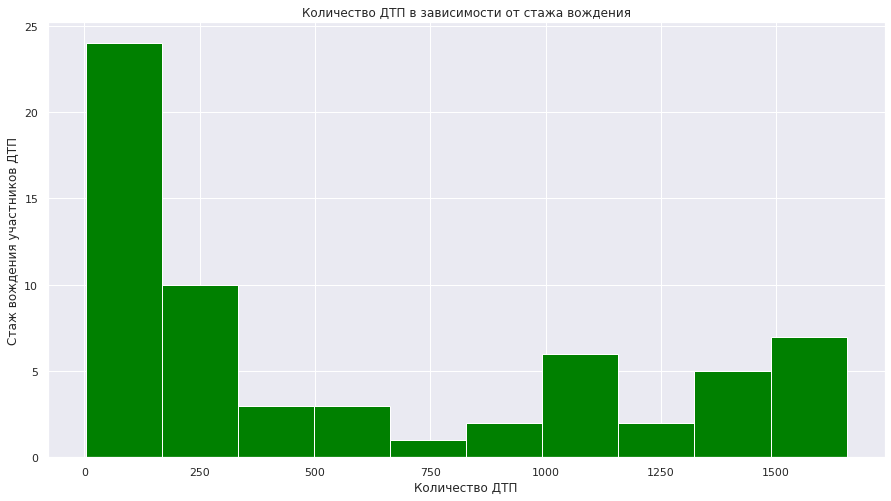

In [ ]:
data_new.groupby('stage')['id'].count().sort_values().hist(bins = 10, figsize=(15, 8), grid=True, color='green')
plt.title('Количество ДТП в зависимости от стажа вождения')
plt.xlabel('Количество ДТП')
plt.ylabel('Стаж вождения участников ДТП')
plt.show()

**Стаж вождения участников ДТП в зависимости от пола**

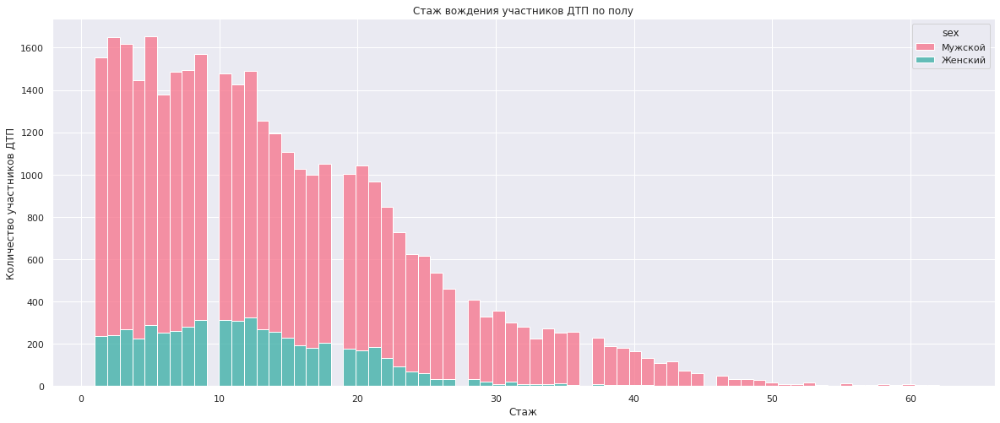

In [ ]:
sns.histplot(data = data_new, x = 'stage', hue='sex', multiple='stack', palette = 'husl')
plt.title('Стаж вождения участников ДТП по полу')
plt.xlabel('Стаж')
plt.ylabel('Количество участников ДТП')
plt.grid(True)
plt.show()

`Основными виновниками ДТП в исследуемом периоде были водители со стажем` **до 10 лет.**

Водители, имеющие большой стаж вождения, реже становятся участниками ДТП.

Среди виновников ДТП женщин-водителей со стажем более 30 лет практически нет.

**В аварии какой степени тяжести попадают водители мужчины и водители женщины:**

In [ ]:
sex_severity = data_new.pivot_table(index=['sex','severity'], values='id', aggfunc = 'count')
sex_severity.columns = ['count']
sex_severity['ratio'] = (sex_severity['count'] / sex_severity['count'].sum()*100).round(2)
sex_severity.sort_values(by='sex', ascending=False).reset_index()

,sex,severity,count,ratio
0,Мужской,Легкий,21469,59.77
1,Мужской,С погибшими,1455,4.05
2,Мужской,Тяжёлый,7214,20.09
3,Женский,Легкий,4408,12.27
4,Женский,С погибшими,142,0.40
5,Женский,Тяжёлый,1229,3.42


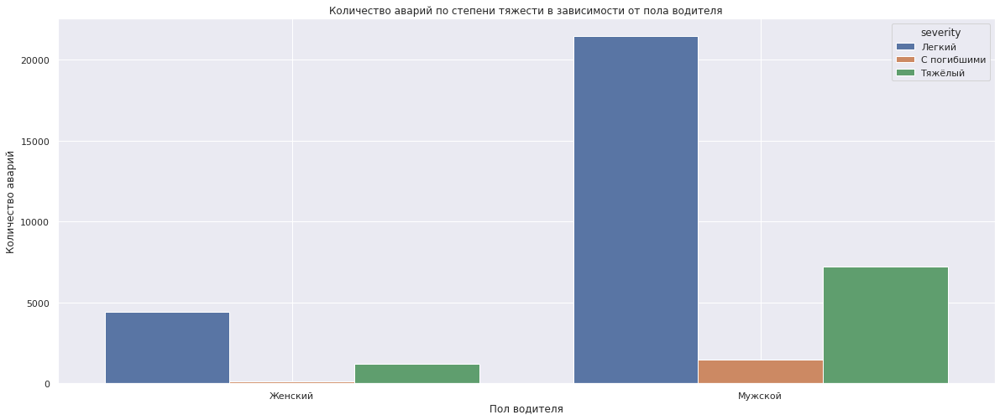

In [ ]:
sns.barplot(data = data_new.groupby(['sex', 'severity'])['id'].count().reset_index(), x = 'sex', y = 'id', hue = 'severity')
plt.title('Количество аварий по степени тяжести в зависимости от пола водителя')
plt.ylabel('Количество аварий')
plt.xlabel('Пол водителя')
plt.grid(True)
plt.show()

`По степени тяжести аварии распределяются следующим образом:`
- среди мужчин:
  - 59,8% - легкая степень;
  - 20,1% - тяжелая степень.
- среди женщин:
  - 12,3% - легкая степень;
  - 3,4% - тяжелая степень.

Доля аварий с погибшими среди всех категорий аварий - незначительна.

**СИТУАЦИЯ В ГОРОДЕ**

**Количество ДТП по районам Москвы:**

In [ ]:
region = data_new.groupby('region')['id'].count().sort_values(ascending=False).to_frame().reset_index()
region.columns = ['region', 'count']
region

,region,count
0,Выхино-Жулебино,590
1,Люблино,580
2,Пресненский,546
3,Спецтрассы,515
4,Даниловский,498
...,...,...
141,Кокошкино,17
142,Матушкино,15
143,Поселок Восточный,12
144,Новофёдоровское поселение,6


In [ ]:
region_1 = region.head(10)

Посмотрим информацию о топ-10 районах Москвы по количеству аварий в исследуемом периоде:

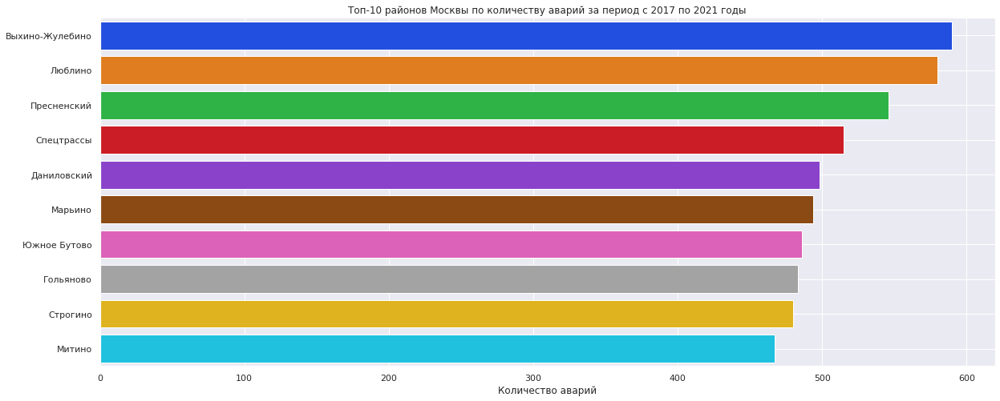

In [ ]:
sns.barplot(data = region_1, x = 'count', y = 'region', palette="bright")
plt.title('Топ-10 районов Москвы по количеству аварий за период с 2017 по 2021 годы')
plt.xlabel('Количество аварий')
plt.ylabel('')
plt.grid(True)
plt.show()         

**Районы Москвы с наибольшим количеством ДТП с распределением по годам:**

In [ ]:
top10region = region.loc[:9, 'region'].values

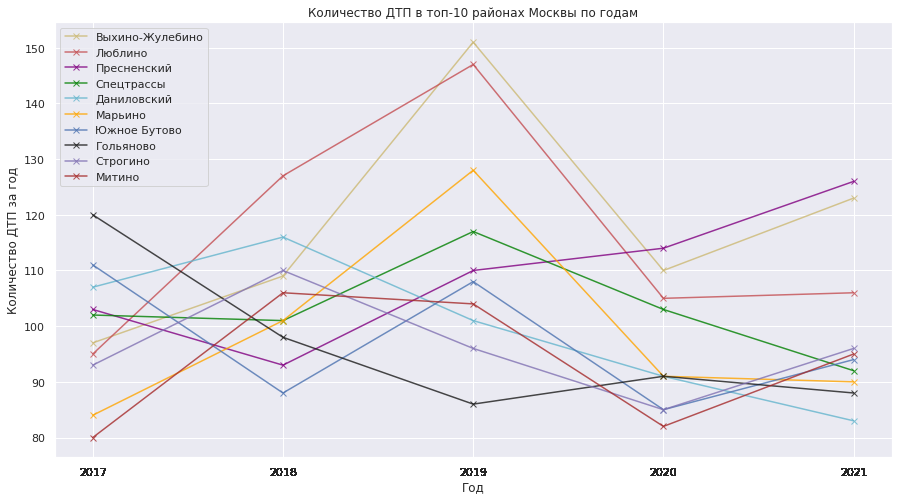

In [ ]:
color = ['y','r','purple','green','c','orange', 'b', 'k', 'm', 'brown']

plt.figure(figsize=(15, 8))
plt.title('Количество ДТП в топ-10 районах Москвы по годам')

av_year_reg = 0
for i in range(0, len(top10region)):
    region_year  = data_new.query('region == @top10region[@i]').groupby('year_of_incident')['id'].count()
    av_year_reg += region_year.count()

    region_year.plot(x = region_year.index, y = region_year.values, style = '-x', color = color[i], label = top10region[i], alpha = 0.8, grid = True);

plt.xlabel('Год')    
plt.ylabel('Количество ДТП за год')
plt.legend()
plt.xticks(data_new.year_of_incident)
plt.show()

`Ситуация в топ-10 районах Москвы с наибольшим количеством ДТП в исследуемом периоде:`
- *Выхино-Жулебино*. Резкий рост количества ДТП к 2019 году. В 2020 году из-за введенных органичений в связи с пандемией наблюдается снижение количества аварий. К концу 2021 года количество аварий снова начало расти;
- *Люблино*. Рост количества ДТП к 2019 году, со снижением в 2020 (пандемия). К концу 2021 года количество ДТП по сравнению с 2020 незначительно увеличилось;
- *Пресненский*. Наблюдается снижение количества ДТП в 2018 году по сравнению с 2017 годом, потом рост без тенденции к снижению;
- *Спецтрассы*. Рост к 2019 году. После постепенное снижение;
- *Даниловский*. Пик количества аварий пришелся на 2018 год. После достаточно сильное снижение количества ДТП;
- *Марьино*. Рост к 2019 году и достаточно сильное снижение к 2020 с тенденцией к снижению и в 2021 году;
- *Южное Бутово*. В исследуемом периоде в данном районе количество ДТП  менялось от снижения к увеличению;
- *Гольяново*. В 2017 году это был район с наибольшим количеством ДТП. После 2017 года рост ДТП достаточно резко снизился и продолжает снижаться без каких-либо всплесков;
- *Строгино*. Рост количества аварий к 2018 году с постепенным снижением к концу 2020 года. В 2021 году количество ДТП снова увеличилось;
- *Митино*. Рост количества аварий к 2018 году. После 2019 года снижение (во время пандемии). После снятия ограничений количество ДТП снова начало увеличиваться.

**Районы Москвы с наибольшим количеством смертельных исходов в результате ДТП:**

In [ ]:
region_dead = data_new.groupby('region')['dead_count'].sum().sort_values(ascending=False).to_frame().reset_index()
region_dead_top = region_dead.head(10)

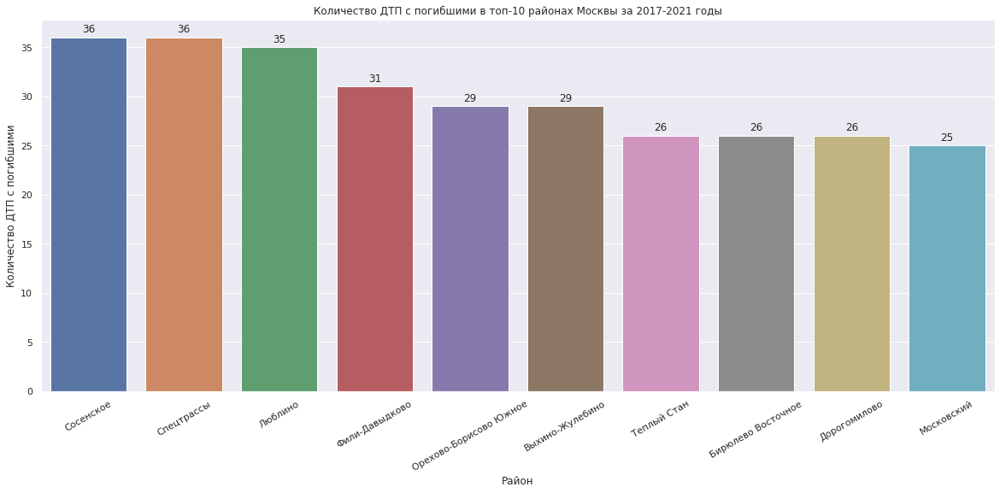

In [ ]:
sns.set(rc={'figure.figsize':(20,8)})
ax = sns.barplot(x='region', y='dead_count', data=region_dead_top)
ax.set(title='Количество ДТП с погибшими в топ-10 районах Москвы за 2017-2021 годы')
ax.set_ylabel('Количество ДТП с погибшими')
ax.set_xlabel('Район')
ax.tick_params(axis='x', labelrotation=30)

for p in ax.patches:
  height = p.get_height()
  ax.text(x = p.get_x()+(p.get_width()/2), 
  y = height+0.5, 
  s = '{:.0f}'.format(height), 
  ha = 'center')

`Количество ДТП со смертельным исходом в этих районах вызвано, в основном:` 
- управлением автомобилем в состоянии наркотического и алкогольного опьянения;
- нарушением скоростного режима;
- нарушением правил проезда пешеходного перехода.

**Районы Москвы участники ДТП чаще получают травмы:**

In [ ]:
region_injured = data_new.groupby('region')['injured_count'].sum().sort_values(ascending=False).to_frame().reset_index()
region_injured_top = region_injured.head(10)

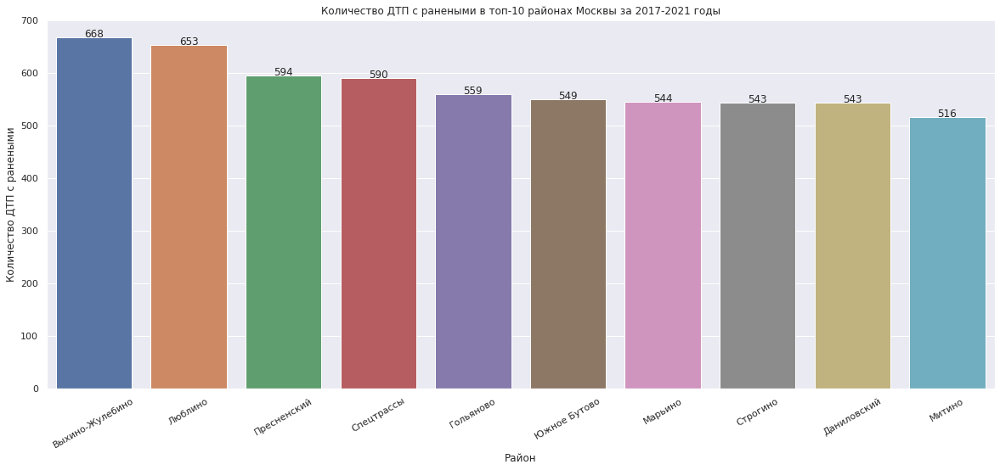

In [ ]:
sns.set(rc={'figure.figsize':(20,8)})
ax = sns.barplot(x='region', y='injured_count', data=region_injured_top)
ax.set(title='Количество ДТП с ранеными в топ-10 районах Москвы за 2017-2021 годы')
ax.set_ylabel('Количество ДТП с ранеными')
ax.set_xlabel('Район')
ax.tick_params(axis='x', labelrotation=30)

for p in ax.patches:
  height = p.get_height()
  ax.text(x = p.get_x()+(p.get_width()/2), 
  y = height+0.5, 
  s = '{:.0f}'.format(height), 
  ha = 'center')

`Причины такого количества раненых в авариях в этих районах те же, в основном это:`
- управление автомобилем в состоянии наркотического и алкогольного опьянения;
- нарушение скоростного режима;
- нарушение правил проезда пешеходного перехода.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# загрузим данные с координаиами районов Москвы
with open ('/content/drive/MyDrive/Colab Notebooks/Проект/Геоаналитика/Анализ ДТП в Москве/mo.geojson', 'r') as j:
  contents = json.loads(j.read())

In [ ]:
data_1 = gpd.GeoDataFrame.from_features(contents)

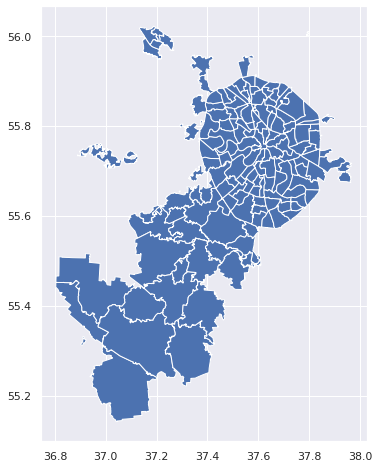

In [ ]:
gpd.read_file('/content/drive/MyDrive/Colab Notebooks/Проект/Геоаналитика/Анализ ДТП в Москве/mo.geojson').plot();

In [ ]:
# удалим ненужные столбцы
data_1 = data_1.drop(columns=['OKATO', 'OKTMO', 'NAME_AO', 'OKATO_AO', 'ABBREV_AO', 'TYPE_MO'], axis = 1)

In [ ]:
data_1.rename(columns={'NAME': 'region'}, inplace=True)

In [ ]:
rayons_viz = data_new.groupby('region')['id'].count().reset_index().merge(data_1[['geometry', 'region']], on = 'region').drop_duplicates(['region'])

In [ ]:
rayons_viz.sample()

,region,id,geometry
74,Орехово-Борисово Северное,243,"POLYGON ((37.67127 55.62009, 37.67336 55.62151..."


**Построим тепловую карту по количеству аварий в районах Москвы за последние 5 лет**

In [ ]:
from folium.plugins import HeatMap
m = folium.Map(location=[55.7522, 37.6156], zoom_start = 10, tiles = 'Stamen Toner')
# drawing heatmap
lat = data_new.lat.tolist()
lng = data_new.long.tolist()
HeatMap(list(zip(lat, lng))).add_to(m)

# drawing borders of rayons
for _, r in rayons_viz.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geojson = geo.to_json()
    geojson = folium.GeoJson(data=geojson)
   
    
    # creating popup with the name of the region and the total number of accidents for the last 5 years
    folium.Popup(str(r['region']) +': ' + str(r['id']) + ' accidents for all period').add_to(geojson)
    geojson.add_to(m)


m

**Визуализируем аварии по районам по сезонам в 2021 году**

In [ ]:
rayon_season_2021 = data_new.query('year_of_incident == 2021')
rayon_season_2021_inc = rayon_season_2021[['id', 'geometry', 'address', 'season']]

In [ ]:
from folium import plugins
from folium.plugins import MarkerCluster

# загрузим карту Москвы
map_Moscow = folium.Map(location=[55.7522200, 37.6155600], zoom_start=10, tiles = 'Stamen Toner')

accident_points = list(rayon_season_2021_inc['geometry'])

mCluster_winter = MarkerCluster(name='Зима', show=True).add_to(map_Moscow)
mCluster_spring = MarkerCluster(name='Весна', show=False).add_to(map_Moscow)
mCluster_summer = MarkerCluster(name='Лето', show=False).add_to(map_Moscow)
mCluster_autumn = MarkerCluster(name='Осень', show=False).add_to(map_Moscow)


for p, s, label in zip(
    accident_points,
    rayon_season_2021_inc['season'],
    rayon_season_2021_inc['address'],
):
    marker = folium.Marker(
        location=[p.coords[0][1], p.coords[0][0]], icon=None, popup=label
    )
    if s == 'Зима':
        mCluster_winter.add_child(marker)
    elif s == 'Весна':
        mCluster_spring.add_child(marker)
    elif s == 'Лето':
        mCluster_summer.add_child(marker)
    elif s == 'Осень':
        mCluster_autumn.add_child(marker)


folium.LayerControl().add_to(map_Moscow)
map_Moscow

**Визуализируем на карте аварии, произошедшие в 2021 году, в зависимости от степени тяжести**

In [ ]:
rayons_viz_2021 = data_new.query('year_of_incident == 2021').groupby(['region', 'severity'])['id'].count().reset_index()
rayons_viz_2021['severity_id'] = rayons_viz_2021['severity'] + ': ' + rayons_viz_2021['id'].astype('str')  + ' accidents'
to_merge = rayons_viz_2021.groupby('region')['severity_id'].unique().reset_index()
rayons_viz_2021_severity = to_merge.merge(data_1[['geometry', 'region']], on = 'region').drop_duplicates(['region'])

In [ ]:
lat = list(data_new.query('year_of_incident == 2021')['lat'])
lon = list(data_new.query('year_of_incident == 2021')['long'])
severity = list(data_new.query('year_of_incident == 2021')['severity'])
def color_producer(severity):
    if severity == 'Легкий':
        return 'green'
    elif severity == 'Тяжёлый':
        return 'orange'
    else:
        return 'red'

m = folium.Map(location=[55.7522, 37.6156], zoom_start=10, tiles = 'Stamen Toner')
sev = folium.FeatureGroup(name='Severity')

for lt, ln, severity in zip(lat, lon, severity):
    sev.add_child(folium.CircleMarker(location=[lt, ln], radius = 0.5, 
    fill_color=color_producer(severity), fill=True,  color = color_producer(severity), fill_opacity=0.7))
m.add_child(sev)

for _, r in rayons_viz_2021_severity.iterrows():

    geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = geo.to_json()
    geo_j = folium.GeoJson(data=geo_j)
    
    folium.Popup(str(r['region']) +': ' + str(r['severity_id'] )).add_to(geo_j)
    geo_j.add_to(m)
m

**Визуализируем на карте аварии, произошедшие в 2021 году, в зависимости от пола водителя**

In [ ]:
rayons_viz_2021 = data_new.query('year_of_incident ==2021').groupby(['region', 'sex'])['id'].count().reset_index()
rayons_viz_2021['sex_id'] = rayons_viz_2021['sex'] + ': ' + rayons_viz_2021['id'].astype('str')  + ' accidents'
to_merge = rayons_viz_2021.groupby('region')['sex_id'].unique().reset_index()
rayons_viz_2021_sex = to_merge.merge(data_1[['geometry', 'region']], on = 'region').drop_duplicates(['region'])

In [ ]:
lat = list(data_new.query('year_of_incident == 2021')['lat'])
lon = list(data_new.query('year_of_incident == 2021')['long'])
sex = list(data_new.query('year_of_incident == 2021')['sex'])
def color_producer(severity):
    if sex ==  'Мужской':
        return 'red'
    else:
        return 'green'

m = folium.Map(location=[55.7522200, 37.6155600], zoom_start=10, tiles = 'Stamen Toner')
sev = folium.FeatureGroup(name='Sex')

for lt, ln, sex in zip(lat, lon, sex):
    sev.add_child(folium.CircleMarker(location=[lt, ln], radius = 0.5, 
    fill_color=color_producer(sex), fill=True,  color = color_producer(severity), fill_opacity=0.7))
m.add_child(sev)

for _, r in rayons_viz_2021_sex.iterrows():

    geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = geo.to_json()
    geo_j = folium.GeoJson(data=geo_j)
    
    folium.Popup(str(r['region']) +': ' + str(r['sex_id'] )).add_to(geo_j)
    geo_j.add_to(m)
m

# ВЫВОД:

`Мы изучили данные о дорожно-транспортных происшествиях на территории города Москвы за период с 2017 по 2021 год и выяснили:`

В период с 2017 по 2019 год количество ДТП постепенно увеличивалось. 

В 2020 произошло снижение количества ДТП, что, скорее всего, вызвано введенными на территории г.Москвы ограничениями, связанными с пандемией COVID-19.

В 2021 году общее количество ДТП снова начало расти.


---

`Наибольшее количество аварий происходит:`
- в светлое время суток - 59% от всего количества аварий;
- в темное время суток при включенном освещении - 39%.

`Количество аварий` `возрастает с началом рабочего дня` (с 7 до 8 часов утра).

В течение дня оно постепенно увеличивается. К ночи снижается.

`Наибольшее количество` ДТП совершается `в период времени с 17 до 19 часов`. По завершении рабочего дня.

`Погодные условия в момент совершения ДТП (доля от общего количества аварий):`
- пасмурно - 51%;
- ясно - 42%;
- дождь -4%.

`Дорожное покрытие в момент ДТП, в основном (доля от общего количества аварий):`
- сухое - 53%;
- мокрое -24%.

---

`Чаще` всего ДТП происходят `в осенне-зимний сезон`.

Это связано с ухудшением погодных условий, а также трудностью перехода некоторых водителей на особенности зимнего стиля вождения.

`Увеличение количества ДТП в летний сезон, в основном, связано:`
- с появлением множества велосипедов, скутеров и мотоциклов. Следовательно, вероятность ДТП с их участием резко возрастает;
- с жаркой погодой, которая негативно влияет на автомобилистов. Снижается скорость реакции, стиль вождения становится более агрессивным.

---
`В начале года` количество аварий `незначительно`.

`К середине года` оно начинает `постепенно увеличиваться`, `достигая пика к` 3 кварталу - `началу осенне-зимнего сезона`.

*Исключением стал первый квартал 2020 года, в котором количество совершенных ДТП снизилось до минимума. Это вызвано введением ограничений на передвижение (локдаун) в период пандемии.

После частичного снятия ограничений количество аварий стало снова расти.

---
`В разрезе категорий:`
- 47% аварий - столкновение.
- 39% - наезд на пешехода.

---
`По степени тяжести распределяются следующим образом:`
- легкая - 72%;
- тяжелая - 24%;
- с погибшими - 4%.

`Наибольшее число аварий` *любой степени тяжести* совершается `в осенне-зимний период`.

`В весенний период количество аварий` с последствиями `снижается`.

---
В основном, `аварии совершаются` водителями `мужского пола` - `84%`.

`Женщины` принимали участие в `16%` аварий.

Это связано с тем, что женщин-водителей гораздо меньше, чем мужчин, и они более аккуратны и внимательнее при вождении.

---

`Основными виновниками ДТП` в исследуемом периоде были водители `со стажем до 10 лет`.

Водители, имеющие `большой стаж` вождения, `реже` становятся участниками ДТП.

---
`По степени тяжести аварии распределяются следующим образом:`
- среди мужчин:
  - 59,7% - легкая степень;
  - 20,1% - тяжелая степень.
- среди женщин:
  - 12,3% - легкая степень;
  - 3,4% - тяжелая степень.

Доля аварий с погибшими среди всех категорий аварий - незначительная.

---
`Топ-10 районов Москвы с наибольшим количеством ДТП:`
- Выхино-Жулебино;
- Люблино;
- Пресненский;
- Даниловский;
- Марьино;
- Гольяново;
- Строгино;
- Южное Бутово;
-Митино. 

`Количество ДТП со смертельным исходом/ранениями в этих районах вызвано, в основном:` 

1. Со стороны водителя:
- управлением автомобилем в состоянии наркотического и алкогольного опьянения;
- нарушением скоростного режима;
- нарушением правил проезда пешеходного перехода.

2. Со стороны пешеходов:
- беспечностью и невнимательностью;
- переходом дороги в неположенном месте.

---
В Москве сотрудниками ГИБДД, педагогами дошкольных и преподавателями образовательных учреждений ведется работа по профилактике ДТП.

Число ДТП благодаря пропаганде Правил дорожного движения снижается. 

В 2017 году количество случаев в Москве составило 7 376, а в 2021 – 6 857. 

Чтобы прогресс увеличивался, необходимо задействовать больше профессионалов для объяснения населению того, что такое безопасность на дорогах, причин ДТП и правилам поведения на дорогах.